In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
from google.colab.output import eval_js
def shrink(height="300"):
    eval_js(f'google.colab.output.setIframeHeight({height})')

Get the data - only need to run once

In [6]:
numpy_data_path = "/content/drive/MyDrive/numpy_images"

Set up environment

In [7]:
! pip install --upgrade pip
! pip install torch torchvision torchsummary gca pandas numpy matplotlib seaborn scikit-learn==0.23.2 pycocotools tqdm umap-learn kneed
! pip install git+https://github.com/waleedka/cocoapi.git#egg=pycocotools&subdirectory=PythonAPI
# TODO: install the docem python package via github
! pip list
shrink()

     |████████████████████████████████| 1.6 MB 8.1 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 21.1.3
    Uninstalling pip-21.1.3:
      Successfully uninstalled pip-21.1.3
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/include/python3.7/UNKNOWN
sysconfig: /usr/include/python3.7m/UNKNOWN
distutils: /usr/local/bin
sysconfig: /usr/bin
distutils: /usr/local
sysconfig: /usr
user = False
home = None
root = None
prefix = None
     |████████████████████████████████| 6.8 MB 7.9 MB/s 
     |████████████████████████████████| 80 kB 10.2 MB/s 
     |████████████████████████████████| 1.1 MB 35.3 MB/s 
  Created wheel for gca: filename=gca-0.1-py3-none-any.whl size=12304 sha256=6660eb29669089f95b91cfe1954b55c1650c33214044dc0ad39d6d8eb53fda18
  Stored in directory: /root/.cache/pip/wheels/68/85/d1/f5ac3c697ed91a03

Choose a GPU runtime

In [8]:
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
    print(torch.cuda.current_device())
    print(torch.cuda.device_count())
    print(torch.cuda.get_device_name(0))
    
device

0
1
Tesla T4


device(type='cuda', index=0)

In [9]:
import os
import multiprocessing as mp
import random
import sys

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import torch 
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm

In [11]:
import os
import json
print(os.getcwd())

os.chdir("/content/drive/MyDrive/numpy_images/")
print(os.listdir())

embeddings_path = "di_embed_val_batch_41.pt"
mapping_path = "di_index2cocoIDs.json"
embeddings = torch.load(embeddings_path,map_location=torch.device('cpu'))

with open(mapping_path, 'r') as fp:
    idx2Img = json.load(fp)
    
idx2Img = dict(zip(list(map(int, idx2Img.keys())), list(idx2Img.values())))
print(idx2Img)


/content
['data', 'annotations', 'resnext_embeddings.json', 'resnext_embeddings.pt', 'di_index2cocoIDs.json', 'di_embed_val_batch_41.pt']
{0: 522418, 1: 184613, 2: 397133, 3: 574769, 4: 374628, 5: 328757, 6: 293802, 7: 37777, 8: 384553, 9: 368402, 10: 87038, 11: 515289, 12: 562150, 13: 173350, 14: 383445, 15: 565797, 16: 394892, 17: 310391, 18: 241876, 19: 462341, 20: 122851, 21: 138246, 22: 197254, 23: 37675, 24: 296649, 25: 19358, 26: 184791, 27: 74331, 28: 579664, 29: 452684, 30: 527040, 31: 350341, 32: 281533, 33: 289393, 34: 281221, 35: 354533, 36: 181666, 37: 545959, 38: 511058, 39: 91227, 40: 334321, 41: 207797, 42: 179558, 43: 15085, 44: 467522, 45: 40102, 46: 403020, 47: 6005, 48: 402559, 49: 189550, 50: 505440, 51: 241691, 52: 290570, 53: 28758, 54: 163020, 55: 281455, 56: 17756, 57: 155885, 58: 231408, 59: 305821, 60: 190056, 61: 121041, 62: 156397, 63: 173574, 64: 208589, 65: 267571, 66: 73830, 67: 82258, 68: 95022, 69: 153299, 70: 216482, 71: 8665, 72: 573291, 73: 161470, 

In [32]:
# Img Ids to query
random.seed(10)
#TODO: Madhuri
#Commenting this out so that same images (as in Michael's) can be used for results
#query_images = random.sample(list(idx2Img.values()), 10)
query_images = [558661, 123071, 535156, 185614, 8493, 538859, 10583, 254976, 176847, 369594]
print(query_images)
# Position of query images in embedding space
query_idxs = [key for key, value in idx2Img.items() if idx2Img[key] in query_images]

print("query image ids: ", query_images)
print("query image idxs: ", query_idxs)

[558661, 123071, 535156, 185614, 8493, 538859, 10583, 254976, 176847, 369594]
query image ids:  [558661, 123071, 535156, 185614, 8493, 538859, 10583, 254976, 176847, 369594]
query image idxs:  [489, 1075, 6790, 9147, 14139, 15248, 15905, 16191, 18836, 19056]


In [24]:

# Update based on the location in your system
annot_file = "annotations/instances_val2014.json"


In [14]:
!pip install faiss-gpu

distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/lib/python3.7/dist-packages
sysconfig: /usr/lib/python3.7/site-packages
distutils: /usr/local/include/python3.7/UNKNOWN
sysconfig: /usr/include/python3.7m/UNKNOWN
distutils: /usr/local/bin
sysconfig: /usr/bin
distutils: /usr/local
sysconfig: /usr
user = False
home = None
root = None
prefix = None
     |████████████████████████████████| 89.7 MB 6.8 kB/s 
  distutils: /usr/local/include/python3.7/faiss-gpu
  sysconfig: /usr/include/python3.7m/faiss-gpu


In [25]:
print(embeddings.shape)
em_np = embeddings.cpu().numpy()
print(type(em_np))

torch.Size([21002, 1024])
<class 'numpy.ndarray'>


In [26]:
query_embedding = em_np[query_idxs]
print(query_embedding.shape)

(10, 1024)


In [27]:
import faiss
index = faiss.IndexFlatL2(embeddings.shape[1])   # build the index
print(index.is_trained)
index.train(em_np)
index.add(em_np)                  # add vectors to the index
print(index.ntotal)

True
21002


In [28]:
import skimage.io as io
import matplotlib.pyplot as plt
import pylab
import numpy as np
import itertools
from pycocotools.coco import COCO
from mpl_toolkits.mplot3d import Axes3D
from collections import Counter
import pandas as pd

class EmbeddingPlotter:
    def __init__(self, annot_file, embeddings, idx2Img):
        self.annot_file = annot_file
        self.coco = COCO(self.annot_file)
        cats = self.coco.loadCats(self.coco.getCatIds())
        self.cat_id_to_name_dict = {cat['id']: cat['name'] for cat in cats}
        self.img_ids = list(idx2Img.values())
        self.annIds = self.coco.getAnnIds(self.img_ids)
        #self.labels = [self.coco.loadAnns(self.annIds)]
        
        
        
        
        self.embeddings = embeddings
        self.idx2Img = idx2Img
        self.labels = []
        for k, v in self.idx2Img.items():
            ann_ids_to_append = self.coco.getAnnIds(self.idx2Img[k])
            anns_to_append = self.coco.loadAnns(ann_ids_to_append)
            self.labels.append(anns_to_append)
            
        
        self.category_labels=[]
        # self.category_multi_labels = []
        # self.category_multi_labels_counts = []
        self.supercategory_labels = []
        # self.supercategory_multi_labels = []
        # self.supercategory_multi_labels_counts = []
        
        
 
        
        cats_dict = {cat['id']: cat for cat in cats}
        for label in self.labels:
            
            if len(label) > 0:
                categories = []
                supercategories = []
                
                for annotation in label:
                    categories.append(cats_dict[annotation['category_id']]['name'])
                    supercategories.append(cats_dict[annotation['category_id']]['supercategory'])
                # self.category_multi_labels_counts.append(categories)
                # self.category_multi_labels.append(list(set(categories)))
                # self.supercategory_multi_labels.append(list(set(supercategories)))
                # self.supercategory_multi_labels_counts.append(supercategories)
        
                # most common category among objects in the picture
                category, _ = Counter(categories).most_common(1)[0]
                supercategory, _ = Counter(supercategories).most_common(1)[0]
                
                self.category_labels.append(category)
                self.supercategory_labels.append(supercategory)
            else:
                # self.supercategory_multi_labels.append([])
                # self.supercategory_multi_labels_counts.append([])
                # self.category_multi_labels.append([])
                # self.category_multi_labels_counts.append([])
                self.category_labels.append(None)
                self.supercategory_labels.append(None)
        
    def plot_coco_images(self, img_ids, show_labels=True,
                         show_annotations=False, title_suffix=None, figtitle=None):
        coco = self.coco
        cat_id_to_name_dict = self.cat_id_to_name_dict
        nrows = len(img_ids)
        ncols = len(img_ids[0])
    
        fig = plt.figure(figsize=(ncols*6, nrows*6))
    
        for i, img_id in enumerate(itertools.chain(*img_ids)):
            ax = fig.add_subplot(nrows, ncols, i+1)
            img = coco.loadImgs(img_id)[0]
            I = io.imread(img['coco_url'])
    
            ax.imshow(I, aspect='equal', )
            ax.axis('off')
            
            if title_suffix is not None:
                title=f'{img_id}: {title_suffix[i//nrows, i%ncols]}'
            else:
                title = str(img_id)
            ax.set_title(title)
    
        
            annIds = coco.getAnnIds(imgIds=img['id'], iscrowd=None)
            anns = coco.loadAnns(annIds)
            if show_annotations:
                coco.showAnns(anns)
    
            if show_labels:
                for ann in anns:
                    [x, y, _, _] = ann['bbox']
                    label = cat_id_to_name_dict[ann['category_id']]
    
                    t=ax.annotate(label, (x,y), fontsize=12)
                    t.set_bbox(dict(facecolor='white', alpha=0.2, edgecolor='white'))
    
        plt.tight_layout()
        
        if figtitle:
            fig.suptitle(figtitle)
            plt.subplots_adjust(top=0.90)
        plt.show()
        
    def plot_neighbors(self, X_idx, nbrs, show_annotations=False):
        idx2Img = self.idx2Img
        embeddings = self.embeddings
        m, n = np.shape(embeddings)
        img_id = idx2Img[X_idx]
        
        distances, indices = nbrs.kneighbors(embeddings[X_idx, :].reshape(1, n), 16)
        distances, indices = distances[0], indices[0]
        neighbors_ids = np.array(list(map(idx2Img.get, indices)))
        np.insert(neighbors_ids, 0, img_id)
        np.insert(distances, 0, 0)
        
        title_suffix = np.array([f'distance={distance:.2f}' for distance in distances])
        figtitle=f'Neighbors of {img_id}'
        self.plot_coco_images(neighbors_ids.reshape(4, 4).tolist(), 
                         title_suffix=title_suffix.reshape(4,4),
                         show_annotations=show_annotations,
                         figtitle=figtitle)
        
    def plot_3d(self, X, title=None, columns=['x0', 'x1', 'x2'], **kwargs):
        labels = self.supercategory_labels
        
        
        
        df = pd.DataFrame(X, columns=columns)
        df['label'] = labels
        cmap = plt.get_cmap('gist_rainbow')
        unique_labels = list(set(labels))
        labels_dict = {label: i for i, label in enumerate(unique_labels)}
        num_colors = len(unique_labels)
        c = [cmap(1.*labels_dict[label]/num_colors) for label in labels]
    
        df['c'] = c
        df = df[~df['label'].isna()]
        ax = plt.figure(figsize=(16,10)).gca(projection='3d')
        
        for label, grp in df.groupby('label'):
            ax.scatter(
            xs=grp[columns[0]], 
            ys=grp[columns[1]], 
            zs=grp[columns[2]], 
            c=grp['c'], 
            label=label,
            **kwargs
        #     cmap='gist_rainbow'
        )
        
        ax.set_xlabel(columns[0])
        ax.set_ylabel(columns[1])
        ax.set_zlabel(columns[2])
        
        plt.legend(loc='best')
        if title:
            plt.title(title)
        plt.show()

In [29]:
plotter = EmbeddingPlotter(annot_file = annot_file, embeddings=embeddings, idx2Img=idx2Img)

loading annotations into memory...
Done (t=6.26s)
creating index...
index created!


In [30]:
k = 6                         # we want to see 5 nearest neighbors
D, I = index.search(query_embedding, k) # sanity check
print(I)
print(D)

[[  489  2006 11699 10083 11551 19477]
 [ 1075 10166 17075  8681 20887 10526]
 [ 6790 20708  9128  5900  1372  6293]
 [ 9147  3910  9148  1114  8772 15240]
 [14139  7029 14033   441 16259  4846]
 [15248 15249  9287 20835 14764  6088]
 [15905 10811 11120  1097  6229  7545]
 [16191  4365 10977 11172  3841 11387]
 [18836   512  5620 16998 12654  4872]
 [19056 14976  6582 11175 11549  9559]]
[[  0.        19.271889  23.532597  24.742361  25.67209   25.84044 ]
 [  0.        27.027695  43.71545   51.05311   54.46413   62.88978 ]
 [  0.        96.08319  103.10697  108.53289  115.54235  121.25767 ]
 [  0.        35.445957  41.78477   42.83401   48.639786  51.855225]
 [  0.        33.5185    33.77596   36.349113  39.980915  40.479362]
 [  0.        67.12824   75.06965   85.200645  91.042465  94.593254]
 [  0.        41.738277  43.408676  44.275166  44.882664  44.993362]
 [  0.        51.744335  56.600227  58.905926  59.01131   62.416958]
 [  0.        30.281458  37.258175  38.39876   42.54724  

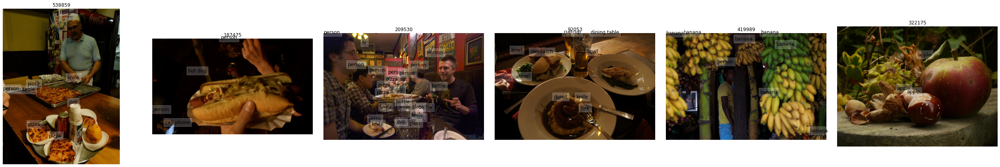

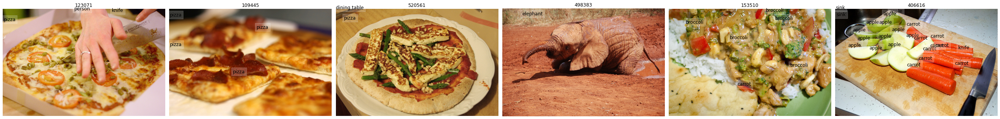

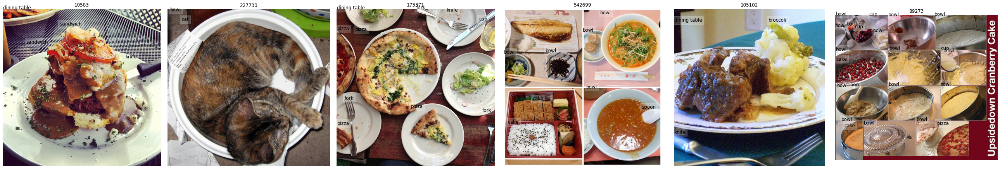

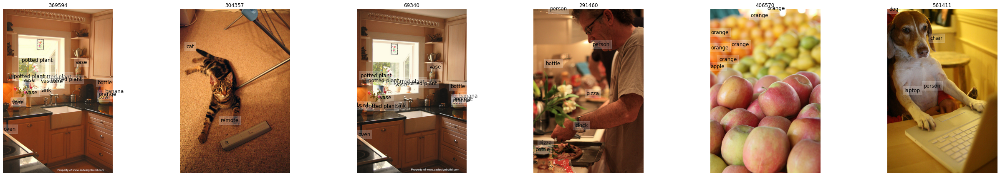

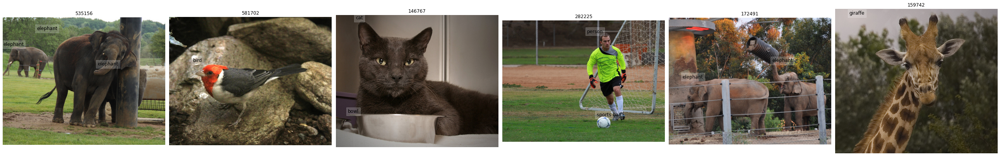

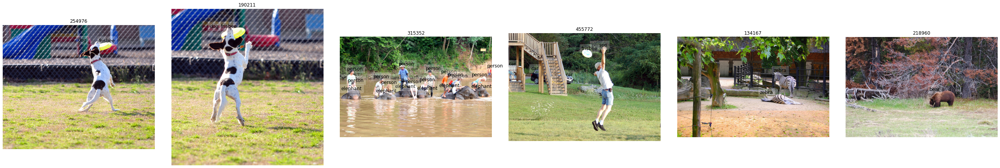

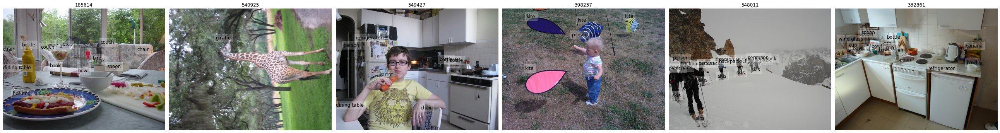

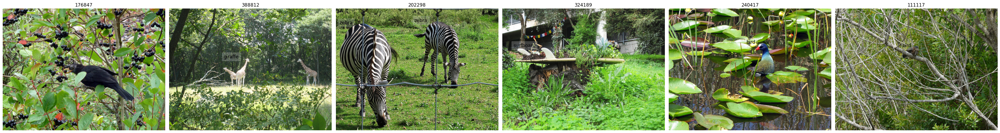

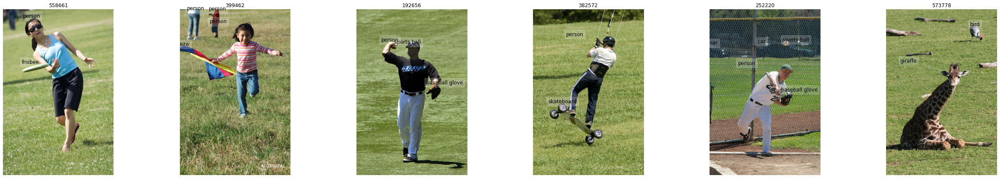

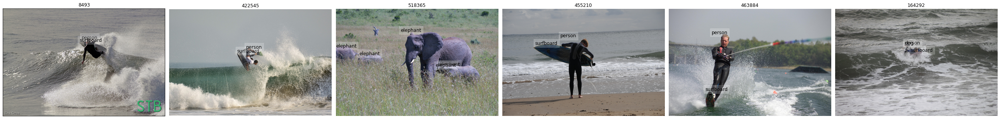

In [31]:
for j in range(I.shape[0]):
  l = []
  for i in range(I.shape[1]):
    l.append(idx2Img[I[j][i]])
  plotter.plot_coco_images([l])
